<a href="https://colab.research.google.com/github/AhmadChaudhry628/AhmadChaudhry628/blob/main/video_object_detection_Ann.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

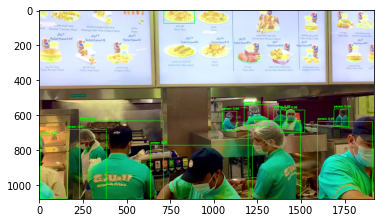

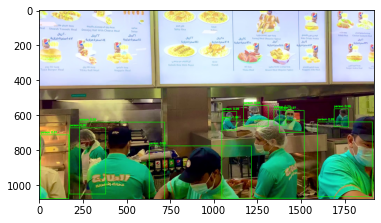

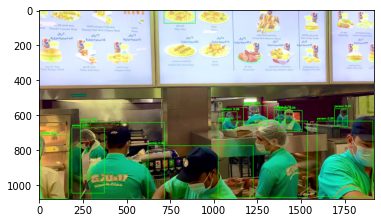

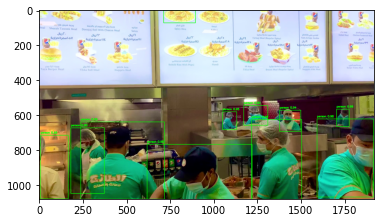

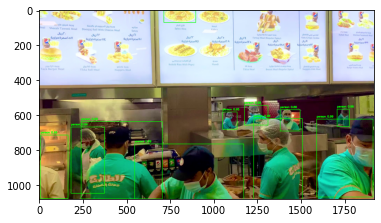

...

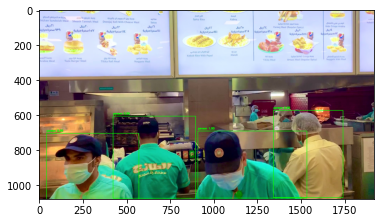

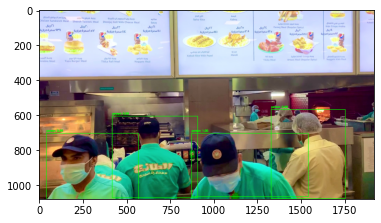

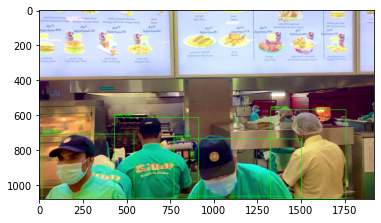

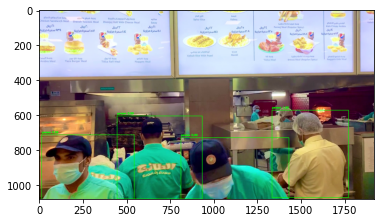

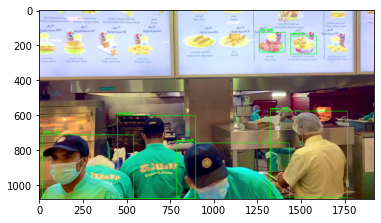

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load YOLOv3 model and classes from COCO dataset
net = cv2.dnn.readNetFromDarknet('/content/yolov3.cfg', '/content/yolov3.weights')
classes = []
with open('/content/coco.names', 'r') as f:
    classes = [line.strip() for line in f.readlines()]

# Set minimum confidence level and non-maximum suppression threshold
conf_threshold = 0.5
nms_threshold = 0.4

# Initialize video capture object
cap = cv2.VideoCapture('/content/video-1.mp4')

# Get dimensions of the video frames
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
# Initialize video writer object
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter('output-1.mp4', fourcc, 30, (width, height))
while True:
    # Read frame from video stream
    ret, frame = cap.read()

    if ret:
        # Create blob from the frame
        blob = cv2.dnn.blobFromImage(frame, 1/255, (416, 416), (0, 0, 0), True, crop=False)

        # Set the input to the neural network
        net.setInput(blob)

        # Run forward pass on the neural network
        output_layers = net.getUnconnectedOutLayersNames()
        layer_outputs = net.forward(output_layers)

        # Extract bounding boxes and confidence levels
        boxes = []
        confidences = []
        class_ids = []
        for output in layer_outputs:
            for detection in output:
                scores = detection[5:]
                class_id = np.argmax(scores)
                confidence = scores[class_id]
                if confidence > conf_threshold:
                    center_x = int(detection[0] * width)
                    center_y = int(detection[1] * height)
                    w = int(detection[2] * width)
                    h = int(detection[3] * height)
                    x = center_x - w // 2
                    y = center_y - h // 2
                    boxes.append([x, y, w, h])
                    confidences.append(float(confidence))
                    class_ids.append(class_id)

        # Perform non-maximum suppression to remove redundant bounding boxes
        indices = cv2.dnn.NMSBoxes(boxes, confidences, conf_threshold, nms_threshold)
        # Draw bounding boxes and labels on the frame
        if len(indices) > 0:
         for i in indices:
           box = boxes[i]
           x, y, w, h = box
           label = str(classes[class_ids[i]])
           confidence = confidences[i]
           color = (0, 255, 0)
           cv2.rectangle(frame, (x, y), (x + w, y + h), color, 2)
           cv2.putText(frame, f'{label} {confidence:.2f}', (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

        # Write the frame to the output video
        out.write(frame)

        # Display the frame
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.show()

        # Check if user pressed 'q' to quit
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
    else:
        break

# Release video capture object and close all windows
cap.release()
out.release()
cv2.destroyAllWindows()
